<a href="https://colab.research.google.com/github/prapar/Brain-MRI-Segmentation/blob/main/Brain_MRI_Segmentation_final_part3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Continued from Part 2...

# Modelling

## Part 2 - Segmentation Model

Now that we have finalized the model to detect the presence of tumors in the scan image, we can proceed to training the models that can predict the mask to show the shape and location of the tumor itself.

We will experiment with the following models and choose the best performing one for segmentation:
1. CANet based architecture
2. Unet with Resnet Backbone

**Choice of Metrics:**

In our problem, we have 2 classes. The location of tumor = 1 (Segmentation Mask) and the no tumor location = 0 (Background Mask). The tumor location is considerably small when compared to the background location of the image.
This means that there is a clear class imbalance that we must deal with. If not, even if the model predicts 0 for the entire mask (i.e., no tumor) we will still have a high accuracy score.
Dice Coefficient implicitly takes care of this class imbalance in its formulation. It is a measure of overlap of the predicted mask and the ground truth. As a result, the background class does not outweigh the segmentation class which is the minor class. The background class is not considered and only the segmentation class is considered in arriving at the Dice coefficient.
The pixels are classified as True Positive (TP), False Negative (FN) and False Positive (FP).

**Dice Coefficient = [2 x TP]/([TP+FP] + [TP+FN])**
 
The Dice coefficient range is: [0,1] 0 means no overlap and 1 means perfect overlap. 
Also, the False Positive and False Negatives are accounted for with equal weightage in the denominator. This is important because we neither want tumor indicated where there is no tumor nor do we want a tumor location to be missed out.

**Dice Loss = (1 - Dice Coefficient)**, is used as the loss function. 

Dice Coefficient maximization is the training goal. 


Data Preparation

We will use the Images that have a tumor and their corresponding masks to train these segmenatation models. As already, we would have run the classifier to detect the presence of tumors as a first step.

In [ ]:
X_train, X_test = train_test_split(df[df['TumorStatus']==1], test_size=0.25, random_state=101)

In [ ]:
# Save test data
X_test.to_excel('/content/gdrive/My Drive/CaseStudy2/X_testSeg.xlsx',index=False)

In [ ]:
# Resize and Normalize the Images.
def preprocess(image_path, mask_path):
  
  # resize to 256 256
  image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
  image = cv2.resize(image,(256,256))
  mask  = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
  mask = cv2.resize(mask,(256,256)) 

  #Normalize
  image = image/255
  # Mask have 2 colors: black(0) and white(255) - so 2 channels
  mask = [(mask == v) for v in [0,255]]   # True False boolean
  mask = np.stack(mask, axis=-1).astype('float') # Standardize values to 1.0, 0.0
  
  return image, mask

In [ ]:
class Dataset:
    def __init__(self,images_file, mask_file):
      #Read Image Path/ mask path
        self.image_path = images_file
        self.mask_path = mask_file

    def __getitem__(self, i):
      # Preprocess image
      image, mask = preprocess(self.image_path[i],self.mask_path[i])
      return image, mask
        
    def __len__(self):
        return len(self.image_path)

class Dataloader(tf.keras.utils.Sequence):    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

    def __getitem__(self, i):        
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])        
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]        
        return tuple(batch)
    
    def __len__(self):
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)


In [ ]:
def visualizeImageData(image_samp, mask_samp):
  # Visualize image data from batches
  print("Image Batch Shape: ", image_samp.shape)
  plt.subplots(figsize=(20,20))
  for i in range(5):  
    plt.subplot(1,5,i+1)
    plt.axis("off")
    plt.imshow(image_samp[i])    
  plt.show()
  print("Mask Batch Shape: ", mask_samp.shape)
  plt.subplots(figsize=(20,20))
  for i in range(5):
    plt.subplot(1,5,i+1)
    plt.axis("off")
    mask = np.argmax(mask_samp[i],axis=-1)
    plt.imshow(mask)
  plt.show()

In [ ]:
train_dataset = Dataset(X_train['Image'].values, X_train['Mask'].values)
test_dataset = Dataset(X_test['Image'].values, X_test['Mask'].values)

BATCH_SIZE=10
train_dataloader = Dataloader(train_dataset, batch_size=10, shuffle=True)
test_dataloader = Dataloader(test_dataset, batch_size=10, shuffle=True)

Visualize sample train data 
Image Batch Shape:  (10, 256, 256, 3)


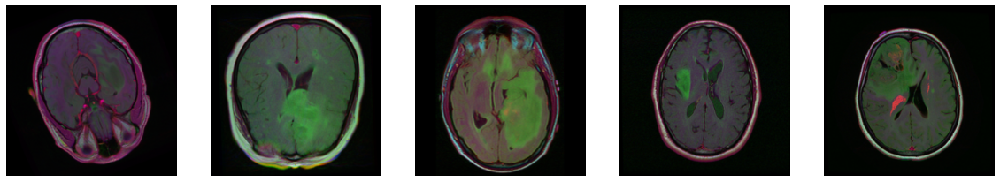

Mask Batch Shape:  (10, 256, 256, 2)


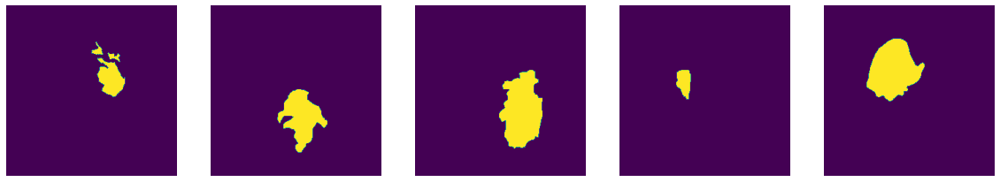

In [ ]:
image_samp,mask_samp = train_dataloader[np.random.randint(X_train.shape[0]//BATCH_SIZE)]
print("Visualize sample train data ")
visualizeImageData(image_samp, mask_samp)

Visualize sample test data 
Image Batch Shape:  (10, 256, 256, 3)


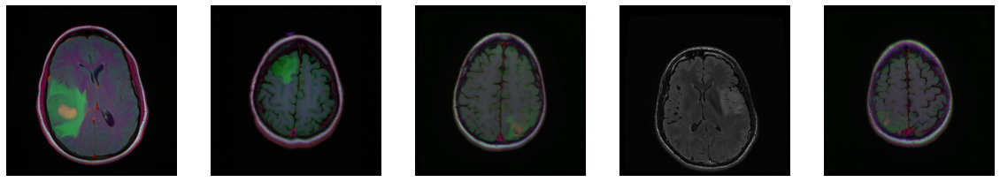

Mask Batch Shape:  (10, 256, 256, 2)


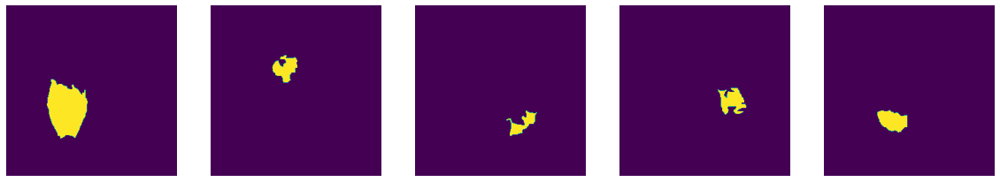

In [ ]:
image_samp,mask_samp = test_dataloader[np.random.randint(X_test.shape[0]//BATCH_SIZE)]
print("Visualize sample test data ")
visualizeImageData(image_samp, mask_samp)

In [ ]:
# Metrics Implementation - Dice Coefficient and Dice Loss
def diceCoef(y_true, y_pred):
  smooth = 1e-05 # to avoid division by zero
  y_truefl = K.flatten(y_true)
  y_predfl = K.flatten(y_pred)
  intxn = K.sum(y_truefl * y_predfl)
  return ((2* intxn +smooth) / (K.sum(y_truefl) + K.sum(y_predfl)+smooth))

def diceCoef_loss(y_true, y_pred):
  return (1-diceCoef(y_true, y_pred)) 

In [ ]:
def visualizeModelPredictions(model,X_test):
  #Visualize random 20 images from the test data along with corresponding segmentation mask and predicted mask.
  count = np.random.randint(len(X_test))
  end = count+19
  for i in range(len(X_test)):
      print('row# ',count)
      #original image
      image = cv2.imread(list(X_test['Image'])[i])
      image = cv2.resize(image, (256,256))

      #predicted segmentation map
      p = cv2.resize(image,(256,256))
      p = p/255
      p = np.expand_dims(p,axis=0)
      pred_mask = model.predict(p,verbose=0)
      pred_mask = np.argmax(pred_mask[0],axis=-1)

      #original segmentation map
      image_mask = cv2.imread(list(X_test['Mask'])[i])
      image_mask = cv2.resize(image_mask, (256,256))

      # plot  
      plt.figure(figsize=(10,6))
      plt.subplot(131)
      plt.axis("off")
      plt.title("Original Image")
      plt.imshow(image)
      plt.subplot(132)
      plt.axis("off")
      plt.title("Original Mask")
      plt.imshow(image_mask)
      plt.subplot(133)
      plt.axis("off")
      plt.title("Predicted Mask")
      plt.imshow(pred_mask)
      plt.show()
      count = count+1
      if count >end:
        break 

In [ ]:
SegModelScores = {}
direc = '/content/gdrive/My Drive/'
filepath=direc+"model_save/model.hdf5"

### 1. CANet Architecture

We will implement a model based on the CANet Architecture.
https://arxiv.org/pdf/2002.12041v1.pdf

In [ ]:
# Define the custom layer blocks

class convolutional_block(tf.keras.layers.Layer):
    def __init__(self, kernel=3,  filters=[4,4,8], stride=1, name="conv_block" ):
        super().__init__(name=name)
        self.F1, self.F2, self.F3 = filters
        self.kernel = kernel
        self.stride = stride

        self.conv_1 = Conv2D(self.F1, (1,1),kernel_initializer='he_normal',padding ='same')
        self.bn_1= BatchNormalization(axis=3)
        self.conv_2 = Conv2D(self.F2,kernel_size= kernel ,strides = stride, kernel_initializer='he_normal', padding = 'same')
        self.bn_2 = BatchNormalization(axis=3)
        self.conv_3 = Conv2D(self.F3, (1,1),kernel_initializer='he_normal', padding = 'same')
        self.bn_3 = BatchNormalization(axis=3)    
        self.conv_4 = Conv2D(self.F3,kernel_size=kernel,strides = stride, kernel_initializer='he_normal', padding = 'same')
        self.bn_4 = BatchNormalization(axis=3)        
        self.add = Add()
        self.active = Activation('relu')

    def get_config(self):
        config = super().get_config().copy()
        config.update({
            'kernel': self.kernel,
            'filters': [self.F1, self.F2, self.F3],
            'stride': self.stride,
        })
        return config

    def call(self, X):
        # first convo block
        x = self.conv_1(X)
        x = self.bn_1(x)
        x = self.active(x)
        # second convo block
        x = self.conv_2(x)
        x = self.bn_2(x)
        x = self.active(x)
        # third convo block
        x = self.conv_3(x)
        x = self.bn_3(x)
        # skip conn.
        skip = self.conv_4(X)
        skip = self.bn_4(skip)
        skip = self.active(skip)
        # Add operation
        x = self.add([x,skip])
        # Activation
        x = self.active(x) 
        return x

class identity_block(tf.keras.layers.Layer):
    def __init__(self, kernel=3,  filters=[4,4,8], name="identity_block"):
        super().__init__(name=name)
        self.F1, self.F2, self.F3 = filters
        self.kernel = kernel

        self.conv_1 = Conv2D(self.F1, (1,1),kernel_initializer='he_normal',padding ='same')
        self.bn_1= BatchNormalization(axis=3)
        self.conv_2 = Conv2D(self.F2,kernel_size= kernel, kernel_initializer='he_normal', padding = 'same')
        self.bn_2 = BatchNormalization(axis=3)
        self.conv_3 = Conv2D(self.F3, (1,1),kernel_initializer='he_normal', padding = 'same')
        self.bn_3 = BatchNormalization(axis=3)
        self.active = Activation('relu')
        self.add = Add()

    def get_config(self):
        config = super().get_config().copy()
        config.update({
            'kernel': self.kernel,
            'filters': [self.F1, self.F2, self.F3],
        })
        return config        
        
    def call(self, X):
        x = self.conv_1(X)
        x = self.bn_1(x)
        x = self.active(x)
        # second convo block
        x = self.conv_2(x)
        x = self.bn_2(x)
        x = self.active(x)
        # third convo block
        x = self.conv_3(x)
        x = self.bn_3(x)
        # Add skip layer i/p- (indentity)
        x = self.add([x,X])
        x = self.active(x)     
        return x

class global_flow(tf.keras.layers.Layer):
    def __init__(self , name="global_flow"):
        super().__init__(name=name)
        
    def build(self, input_shape):
        self.gap = GlobalAveragePooling2D()
        self.reshap = Reshape((1, 1, input_shape[-1]))
        self.bn = BatchNormalization(axis=1)
        self.active = Activation('relu')
        self.conv = Conv2D(input_shape[-1]/2 ,kernel_size=(1,1))
        self.upsample = UpSampling2D(size = (32,input_shape[2]),interpolation='bilinear')        
        
    def call(self, X, training = False):
        # implement the global flow operatiom
        x = self.gap(X)
        x = self.reshap(x)
       # x = tf.expand_dims(x, axis = 1)
       # x = tf.expand_dims(x, axis = 2)
        x = self.bn(x)
        x = self.active(x)
        x = self.conv(x)
        x = self.upsample(x)   
        return x

class context_flow(tf.keras.layers.Layer):    
    def __init__(self, name="context_flow"):
        super().__init__(name=name)
    
    def build(self, input_shape):
        self.ip = input_shape[1][3]
        self.avg_pooling = AveragePooling2D(pool_size=(2, 2),strides=2)
        self.conv3x3_1 =  Conv2D(self.ip, kernel_size = (3,3),padding = 'same')
        self.conv3x3_2 = Conv2D(self.ip, kernel_size = (3,3),padding = 'same')
        self.conv1x1_1 = Conv2D(self.ip, kernel_size = (1,1),padding = 'same')
        # relu activation
        self.active_relu = Activation('relu')
        self.conv1x1_2 = Conv2D(self.ip,  kernel_size = (1,1),padding = 'same')
        self.active_sigmoid = Activation('sigmoid')
        # upsample with size = 2
        self.upsample = UpSampling2D(interpolation='bilinear', size = 2) 
         
    def call(self, X):
        INP, FLOW = X[0], X[1] 
        x= tf.concat([INP,FLOW],axis = -1)
        x= self.avg_pooling(x)
        x= self.conv3x3_1(x)
        x= self.conv3x3_2(x)

        s= self.conv1x1_1(x)
        s= self.active_relu(s)
        s= self.conv1x1_2(s)
        s= self.active_sigmoid(s)
        x1 = multiply([x, s])        
        x = Add()([x1,x])

        x = self.upsample(x)
        return x

class fsm(tf.keras.layers.Layer):    
    def __init__(self, name="feature_selection"):
        super().__init__(name=name)
        
    def build(self, input_shape):
        self.conv3x3 = Conv2D(input_shape[-1], kernel_size=3,padding='same')
        self.gap = GlobalAveragePooling2D()
        self.reshap = Reshape((1, 1, input_shape[-1]))
        self.conv1x1 = Conv2D(input_shape[-1],kernel_size=1, padding='same')
        self.bn = BatchNormalization(axis=1)
        self.active_sigmoid = Activation('sigmoid')
        self.upsample = UpSampling2D(size = 2, interpolation= 'bilinear')

        
    def call(self, X):
        x = self.conv3x3 (X)
        x = self.gap(x)
        x = self.reshap(x)
        x = self.conv1x1(x)
        x = self.bn(x)
        x = self.active_sigmoid(x)
        # Tensor Multiplication of original input to output of sigmoid
        x = X * x
        x = self.upsample(x)
        return x

class agcn(tf.keras.layers.Layer):    
    def __init__(self, name="global_conv_net"):
        super().__init__(name=name)
        self.conv7x1_1 = Conv2D(32, kernel_size =(7,1), padding='same')
        self.conv1x7_1 = Conv2D(32, kernel_size =(1,7), padding='same')
        self.conv1x7_2 = Conv2D(32, kernel_size =(7,1), padding='same')
        self.conv7x1_2 = Conv2D(32, kernel_size =(7,1), padding='same')        
        self.conv3x3 = Conv2D(32, kernel_size =(3,3), padding='same')

    def call(self, X):
        x = self.conv7x1_1(X)
        x = self.conv1x7_1(x)
        x1 = self.conv1x7_2(X)
        x1 = self.conv7x1_2(x1)
        x2 = Add()([x,x1])
        x = self.conv3x3(x2)
        x = Add()([x2,x])
        return x

In [ ]:
# Model Definition
model_name = 'Canet'

conv1 = convolutional_block(stride=2,name='conv_block_1')
id11 = identity_block(name='id_block_11')

conv2 = convolutional_block( filters=[8,8,16], stride=2, name= 'conv_block_2')
id21 = identity_block(filters=[8,8,16], name= 'id_block_21')
id22 = identity_block(filters=[8,8,16], name= 'id_block_22')

conv3 = convolutional_block(filters=[16,16,32], name= 'conv_block_3')
id31 = identity_block(filters=[16,16,32], name= 'id_block_31')
id32 = identity_block(filters=[16,16,32], name= 'id_block_32')
id33 = identity_block(filters=[16,16,32], name= 'id_block_33')

conv4 = convolutional_block(filters=[32,32,64], name= 'conv_block_4')
id41 = identity_block(filters=[32,32,64], name= 'id_block_41')
id42 = identity_block(filters=[32,32,64], name= 'id_block_42')
id43 = identity_block(filters=[32,32,64], name= 'id_block_43')
id44 = identity_block(filters=[32,32,64], name= 'id_block_44')

global_fl = global_flow()

context_1 = context_flow()
context_2 = context_flow(name= 'context_2')
context_3 = context_flow(name= 'context_3')

fsm_block = fsm()

agcn_block = agcn()

conv_final = Conv2D(2,kernel_size=(3,3),padding=  'same')

upsamp = UpSampling2D(interpolation='bilinear', size=(4,4))

active_final = Activation('sigmoid')


# The model
X_input = Input(shape=(256,256,3))
X = Conv2D(64, (3, 3), name='conv1', padding="same", kernel_initializer=glorot_uniform(seed=0))(X_input)
X = BatchNormalization(axis=3, name='bn_conv1')(X)
X = Activation('relu')(X)
X = MaxPooling2D((2, 2), strides=(2, 2))(X)

X = conv1(X)
c1 = id11(X)

X = conv2(c1)
X = id21(X)
X = id22(X)

X = conv3(X)
X = id31(X)
X = id32(X)
X = id33(X)

X = conv4(X)
X = id41(X)
X = id42(X)
X = id43(X)
X = id44(X)

glo_flow = global_fl(X)

ctxt1 = context_1([X,glo_flow])
ctxt2 = context_2([X,ctxt1])
ctxt3 = context_3([X,ctxt2])

X = Add()([glo_flow, ctxt1, ctxt2, ctxt3])

X = fsm_block(X)

agcn = agcn_block(c1)

X = tf.concat([agcn, X], axis = -1)

X = conv_final(X)
X = upsamp(X)
#X = Dropout(0.4)(X)
X = BatchNormalization(axis=1, name='bn_final')(X)
output = active_final(X)
model = Model(inputs = X_input, outputs = output)

model.summary()

Model: "model_23"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_9 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1 (Conv2D)                 (None, 256, 256, 64  1792        ['input_9[0][0]']                
                                )                                                                 
                                                                                                  
 bn_conv1 (BatchNormalization)  (None, 256, 256, 64  256         ['conv1[0][0]']                  
                                )                                                          

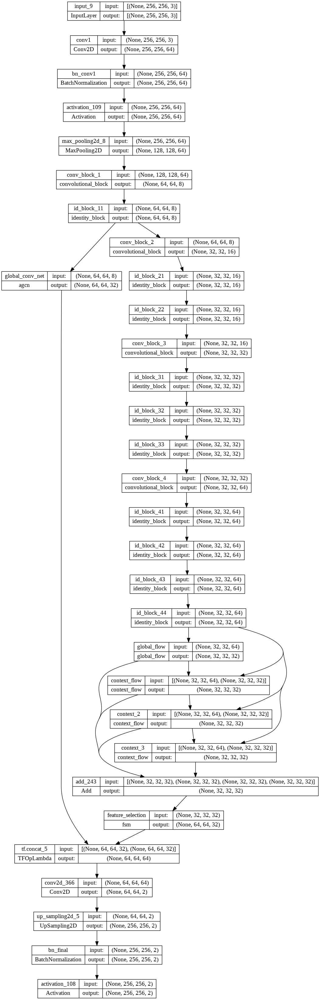

In [ ]:
tf.keras.utils.plot_model(model, to_file=direc+model_name+'.png', show_shapes=True)

In [ ]:
optimize = tf.keras.optimizers.Adam(learning_rate = 0.0001)
model.compile(optimizer = optimize, 
              loss = diceCoef_loss, 
              metrics=[diceCoef])

In [ ]:
# Save the model definition
modelSave(model,model_name)

In [ ]:
checkpoint = ModelCheckpoint(filepath=filepath, monitor='val_diceCoef', verbose=1, save_best_only=True, mode='max')
lrschedule = LearningRateScheduler(changeLearningRate, verbose=0.1)
earlystop = EarlyStopping(monitor='val_diceCoef', patience=3, verbose=1, mode='max')
callback_list = [lrschedule, earlystop, checkpoint, tensorboard_callback]

In [ ]:
hist = model.fit(train_dataloader, 
               validation_data = test_dataloader, 
               epochs = 30, 
               steps_per_epoch = len(train_dataloader),
               callbacks =callback_list
               )


Epoch 1: LearningRateScheduler setting learning rate to 9.999999747378752e-05.
Epoch 1/30
205/205 [==============================] - ETA: 0s - loss: 0.2911 - diceCoef: 0.7089
Epoch 1: val_diceCoef improved from -inf to 0.71396, saving model to /content/gdrive/My Drive/model_save/model.hdf5
205/205 [==============================] - 28s 102ms/step - loss: 0.2911 - diceCoef: 0.7089 - val_loss: 0.2860 - val_diceCoef: 0.7140 - lr: 1.0000e-04

Epoch 2: LearningRateScheduler setting learning rate to 9.999999747378752e-05.
Epoch 2/30
205/205 [==============================] - ETA: 0s - loss: 0.2733 - diceCoef: 0.7267
Epoch 2: val_diceCoef improved from 0.71396 to 0.72537, saving model to /content/gdrive/My Drive/model_save/model.hdf5
205/205 [==============================] - 21s 102ms/step - loss: 0.2733 - diceCoef: 0.7267 - val_loss: 0.2746 - val_diceCoef: 0.7254 - lr: 1.0000e-04

Epoch 3: LearningRateScheduler setting learning rate to 9.499999760009814e-05.
Epoch 3/30
205/205 [===========

In [ ]:
%tensorboard --logdir logs/fits #--host localhost --port 8088

Reusing TensorBoard on port 6006 (pid 3405), started 0:51:22 ago. (Use '!kill 3405' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
os.rename(direc+"model_save/model.hdf5", direc+"model_save/"+model_name+".hdf5")

In [ ]:
diceScore = np.round(max(hist.history['val_diceCoef']),3)
print(diceScore)

0.77


In [ ]:
SegModelScores[model_name] = (diceScore)

row#  221


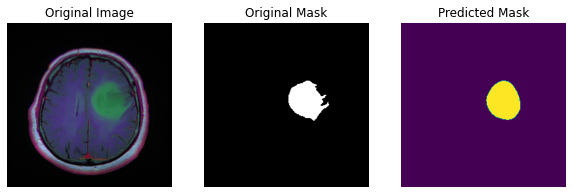

row#  222


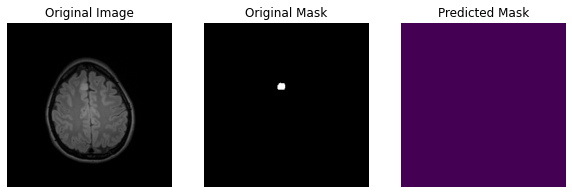

row#  223


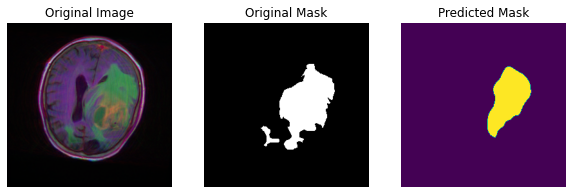

row#  224


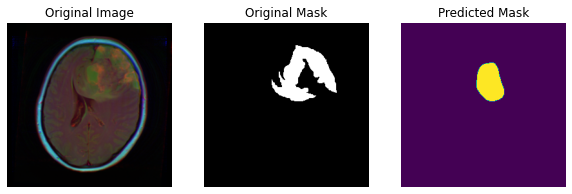

row#  225


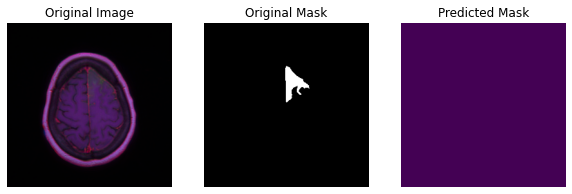

row#  226


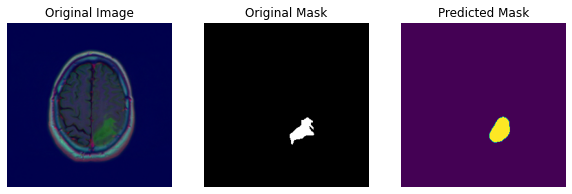

row#  227


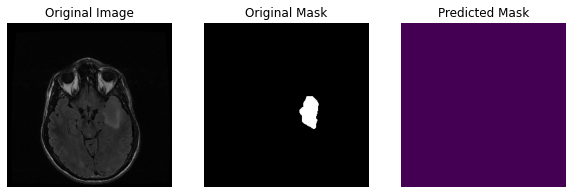

row#  228


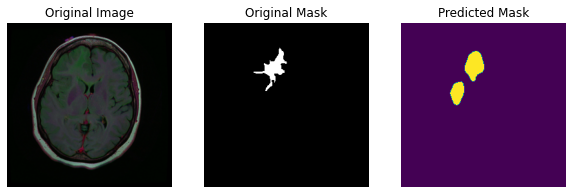

row#  229


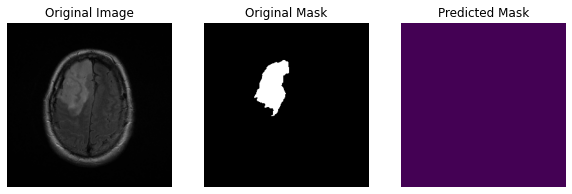

row#  230


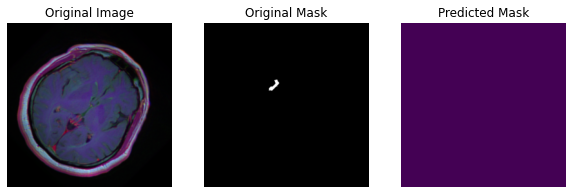

row#  231


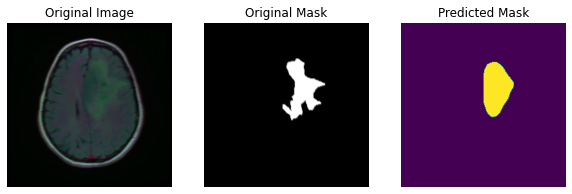

row#  232


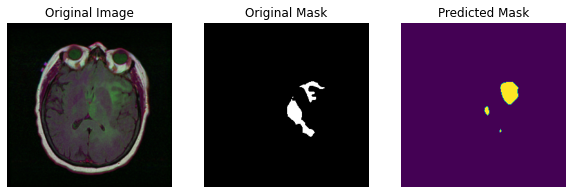

row#  233


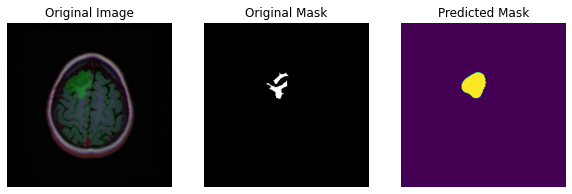

row#  234


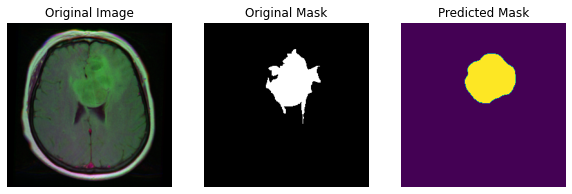

row#  235


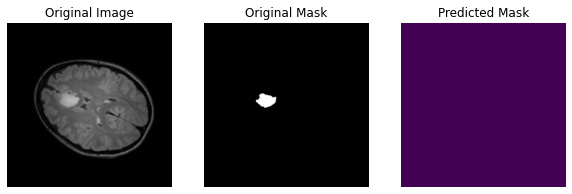

row#  236


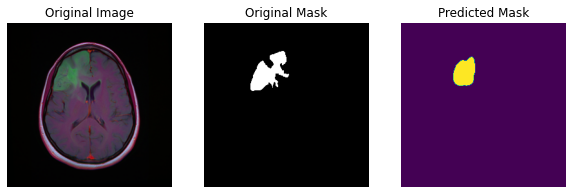

row#  237


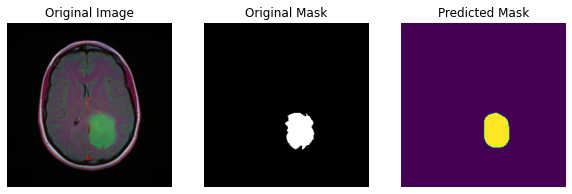

row#  238


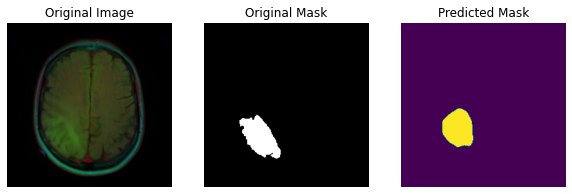

row#  239


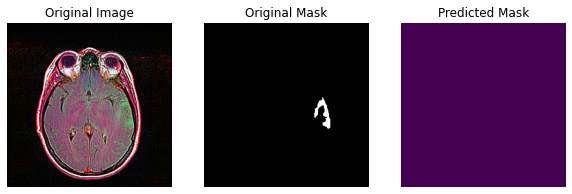

row#  240


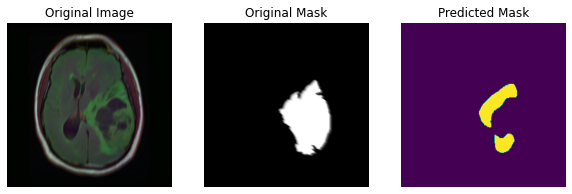

In [ ]:
visualizeModelPredictions(model, X_test)

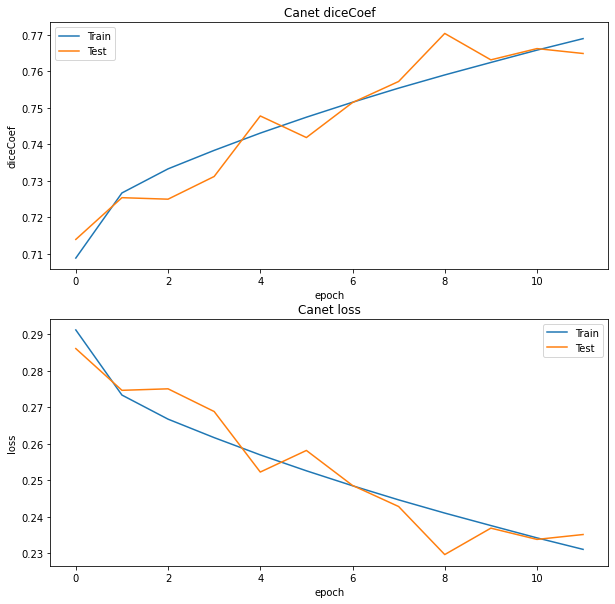

In [ ]:
plotMetrics(model_name, hist, 'diceCoef', 'loss')

As we can clearly see from the segmentation masks predicted, the tumor size, shape and location are not close to the actual values. 

We will experiment with another architecture, to see if the performance (Dice Coefficient) and predictions(Masks) improve.

### 2. Unet with Resnet50 Backbone

We will now train a Unet based model with Resnet50 backbone.

In [ ]:
# Model Definition
model_name = 'Unet'
model = Unet(backbone_name = 'resnet50', 
            input_shape = (256,256,3),
            classes = 2,
            activation = 'sigmoid',
            encoder_weights = 'imagenet',
            encoder_freeze = False)

model.summary()

Model: "model_15"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 data (InputLayer)              [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 bn_data (BatchNormalization)   (None, 256, 256, 3)  9           ['data[0][0]']                   
                                                                                                  
 zero_padding2d_126 (ZeroPaddin  (None, 262, 262, 3)  0          ['bn_data[0][0]']                
 g2D)                                                                                             
                                                                                           

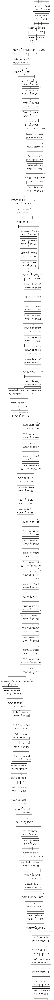

In [ ]:
tf.keras.utils.plot_model(model, to_file=direc+model_name+'.png', show_shapes=True)

In [ ]:
optimize = tf.keras.optimizers.Adam(learning_rate = 0.0001)
model.compile(optimizer = optimize, 
              loss = diceCoef_loss, 
              metrics=[diceCoef])

In [ ]:
# Save the model definition
modelSave(model,model_name)

In [ ]:
checkpoint = ModelCheckpoint(filepath=filepath, monitor='val_diceCoef', verbose=1, save_best_only=True, mode='max')
lrschedule = LearningRateScheduler(changeLearningRate, verbose=0.1)
earlystop = EarlyStopping(monitor='val_diceCoef', patience=2, verbose=1, mode='max')
callback_list = [lrschedule, earlystop, checkpoint, tensorboard_callback]

In [ ]:
hist = model.fit(train_dataloader, 
               validation_data = test_dataloader, 
               epochs = 30, 
               steps_per_epoch = len(train_dataloader),
               callbacks =callback_list
               )


Epoch 1: LearningRateScheduler setting learning rate to 9.999999747378752e-05.
Epoch 1/30
205/205 [==============================] - ETA: 0s - loss: 0.3143 - diceCoef: 0.6857
Epoch 1: val_diceCoef improved from -inf to 0.81223, saving model to /content/gdrive/My Drive/model_save/model.hdf5
205/205 [==============================] - 84s 371ms/step - loss: 0.3143 - diceCoef: 0.6857 - val_loss: 0.1878 - val_diceCoef: 0.8122 - lr: 1.0000e-04

Epoch 2: LearningRateScheduler setting learning rate to 9.999999747378752e-05.
Epoch 2/30
205/205 [==============================] - ETA: 0s - loss: 0.1307 - diceCoef: 0.8693
Epoch 2: val_diceCoef improved from 0.81223 to 0.90864, saving model to /content/gdrive/My Drive/model_save/model.hdf5
205/205 [==============================] - 73s 356ms/step - loss: 0.1307 - diceCoef: 0.8693 - val_loss: 0.0914 - val_diceCoef: 0.9086 - lr: 1.0000e-04

Epoch 3: LearningRateScheduler setting learning rate to 9.499999760009814e-05.
Epoch 3/30
205/205 [===========

In [ ]:
%tensorboard --logdir logs/fits #--host localhost --port 8088

<IPython.core.display.Javascript object>

In [ ]:
os.rename(direc+"model_save/model.hdf5", direc+"model_save/"+model_name+".hdf5")

In [ ]:
diceScore = np.round(max(hist.history['val_diceCoef']),3)
print(diceScore)

0.993


In [ ]:
SegModelScores[model_name] = (diceScore)

row#  309


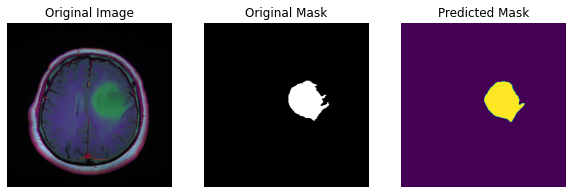

row#  310


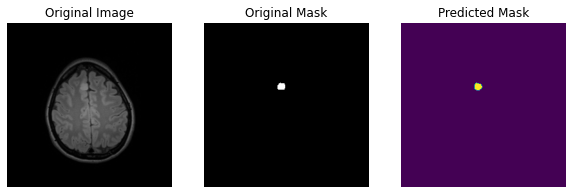

row#  311


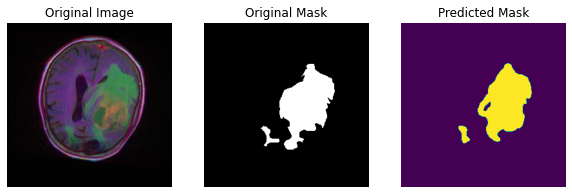

row#  312


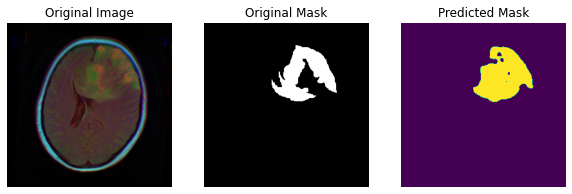

row#  313


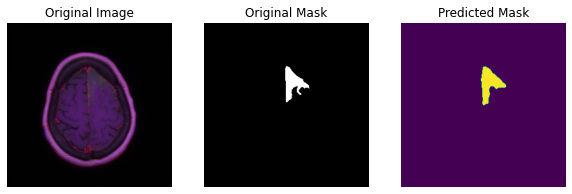

row#  314


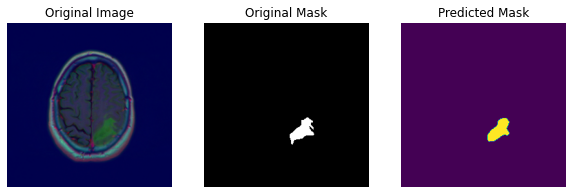

row#  315


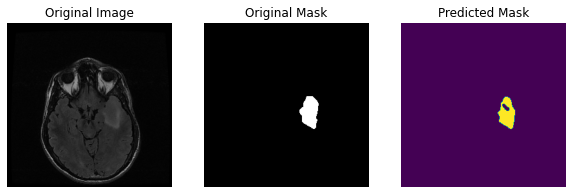

row#  316


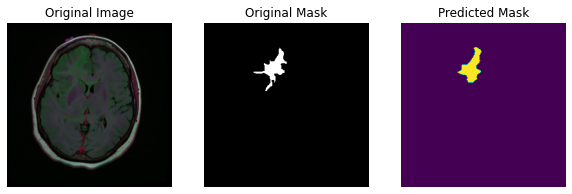

row#  317


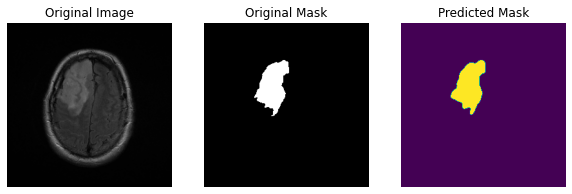

row#  318


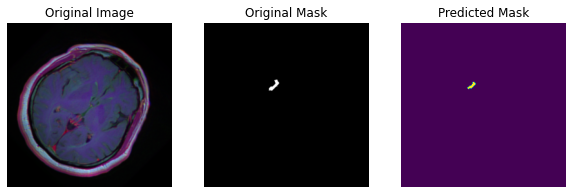

row#  319


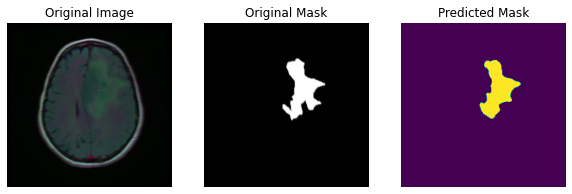

row#  320


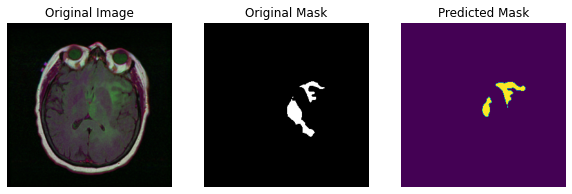

row#  321


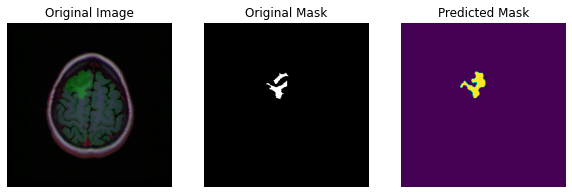

row#  322


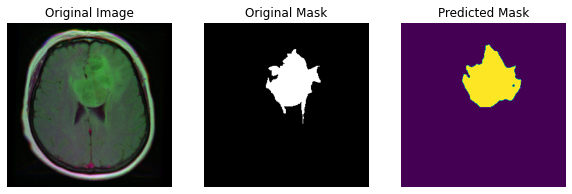

row#  323


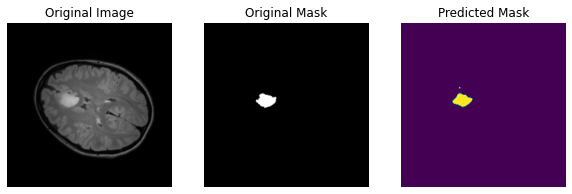

row#  324


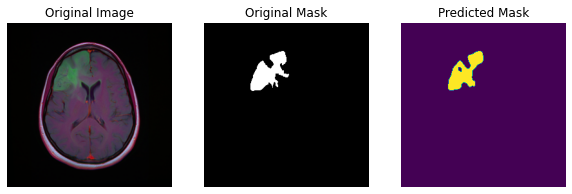

row#  325


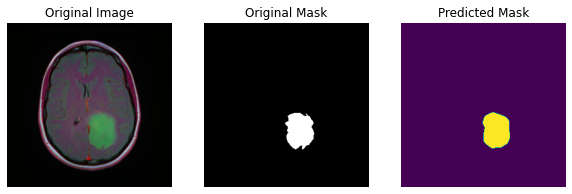

row#  326


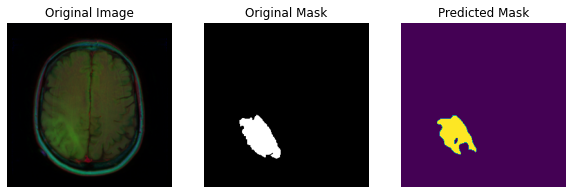

row#  327


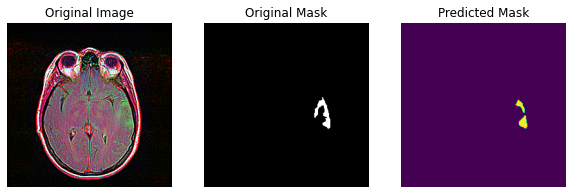

row#  328


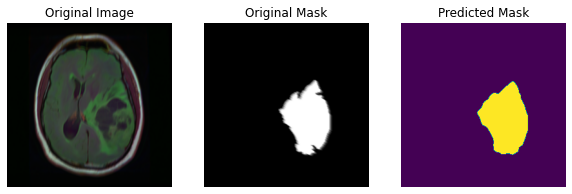

In [ ]:
visualizeModelPredictions(model, X_test)

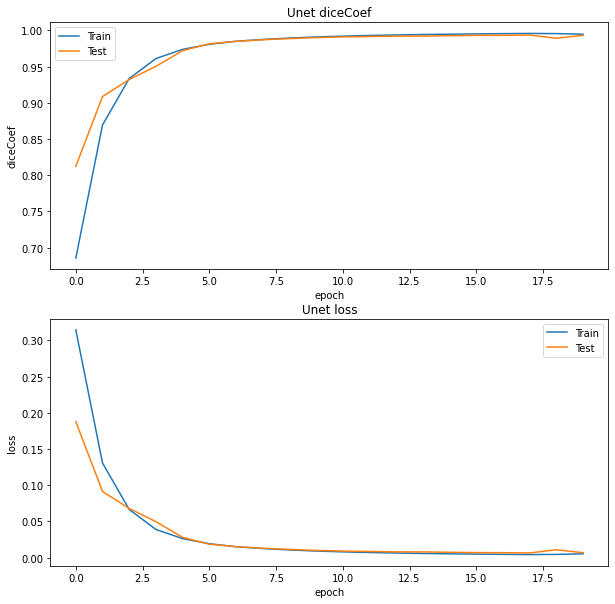

In [ ]:
plotMetrics(model_name, hist, 'diceCoef', 'loss')

Finer details of the tumor are predicted in the mask. The Dice loss has stabilized to a minimum in 20 epochs

# Summary

In [ ]:
pt = PrettyTable(["Seg-Model", "Dice-Coef"])  
pt.add_row(["CANet", SegModelScores['Canet']])
pt.add_row(["Unet", SegModelScores['Unet']])
print(pt)

+-----------+-----------+
| Seg-Model | Dice-Coef |
+-----------+-----------+
|   CANet   |    0.77   |
|    Unet   |   0.993   |
+-----------+-----------+


As we can see the Unet model with Resnet50 backbone, has outperformed the CANet model by a large margin in terms of Dice score.

Also, qualitatively there is clear difference in the predicted segmentation masks.

Unet predicted masks, map the actual tumor site, shape and size very closely to the actual ones.

Hence we will go with the above Unet based architecture Model for our deploy. This will work in tandem with the Xception Network based classifier we had already shortlisted above.

# Pipeline

We will now create a pipeline to combine the Classifier and Segmentation Models

Let us load our Best Classifier and Best Segmentation Model.

In [ ]:
# Load saved models, weights and compile them

# Classifier Model
json_file = open(direc+"model_save/Xception_Classifier.json", 'r')
clfmodel_json = json_file.read()
json_file.close()
clfmodel = model_from_json(clfmodel_json)
# load weights into new model
clfmodel.load_weights(direc+"model_save/Xception_Classifier.hdf5")

# Segmentation Model
json_file = open(direc+"model_save/Unet.json", 'r')
segmodel_json = json_file.read()
json_file.close()
segmodel = model_from_json(segmodel_json)
# load weights into new model

In [ ]:
# Create the prediction pipeline to combine the 2 best models.
def tumorPrediction(data, clfModel, segModel):
  '''
  Predition Pipeline
  Reads: Images and Masks, Classifier Model and Segmentation Model
  Classifier predicts the presence of a tumor, if present the Segmentation model predicts the mask.
  Sample Image, original mask and predicted mask printed.
  Returns: Dataframe with predicted tumor status.
  '''
  data_out = data.copy()
  predStatus = []
  predl = []
  print('Processing...')
  for i in tqdm(data.Image):
    img = cv2.imread(i)
    img = cv2.resize(img,(256,256))
    img = img * 1.0/255.0
    img = np.expand_dims(img,axis=0)

    pred = clfModel.predict(img, verbose=0) # Predict tumor status
    predl.append(pred[0][0])
    if pred[0][0] < 0.5: # Predict labels from the probability values
      predStatus.append(0)
    else:
      predStatus.append(1)

  data_out['PredStatus'] = predStatus
  data_out['Pred'] = predl

  count = np.random.randint(len(data_out))
  end = count+19
  print('Visualizing sample predictions...')
  for i in range(len(data_out)):
      print('-'*75)
      #original image
      image = cv2.imread(list(data_out['Image'])[i])
      image = cv2.resize(image, (256,256))

      #original segmentation map
      image_mask = cv2.imread(list(data_out['Mask'])[i])
      image_mask = cv2.resize(image_mask, (256,256))

      # plot  
      plt.figure(figsize=(10,6))
      plt.subplot(131)
      plt.axis("off")
      plt.title("Original Image")
      plt.imshow(image)
      plt.subplot(132)
      plt.axis("off")
      plt.title("Original Mask")
      plt.imshow(image_mask)      
      if(list(data_out['PredStatus'])[i]==0): # Check classifier prediction label
        print('\033[1m'+' '*20+'NO TUMOR DETECTED IN THE BELOW IMAGE')
      else:
        #predicted segmentation map
        p = image
        p = p/255
        p = np.expand_dims(p,axis=0)
        pred_mask = segmodel.predict(p,verbose=0) # Predict Mask
        pred_mask = np.argmax(pred_mask[0],axis=-1)
        plt.subplot(133)
        plt.axis("off")
        plt.title("Predicted Mask")
        plt.imshow(pred_mask)
      plt.show()
      count = count+1
      if count >end:
        break 
  return data_out  

Processing...


100%|██████████| 150/150 [00:52<00:00,  2.87it/s]


Visualizing sample predictions...
---------------------------------------------------------------------------


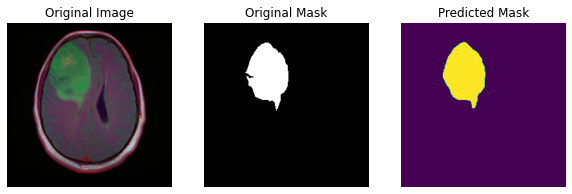

---------------------------------------------------------------------------
                    NO TUMOR DETECTED IN THE BELOW IMAGE


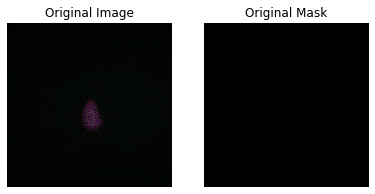

---------------------------------------------------------------------------


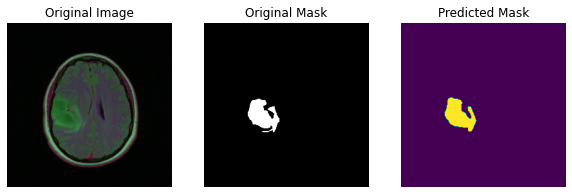

---------------------------------------------------------------------------
                    NO TUMOR DETECTED IN THE BELOW IMAGE


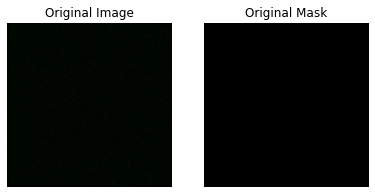

---------------------------------------------------------------------------


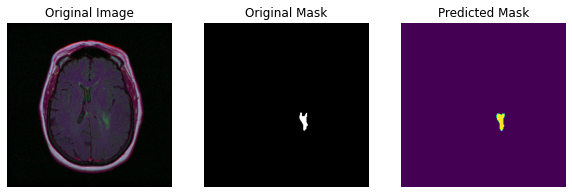

---------------------------------------------------------------------------
                    NO TUMOR DETECTED IN THE BELOW IMAGE


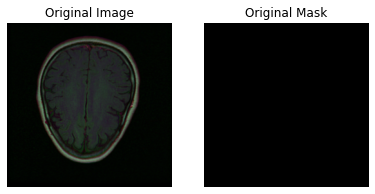

---------------------------------------------------------------------------
                    NO TUMOR DETECTED IN THE BELOW IMAGE


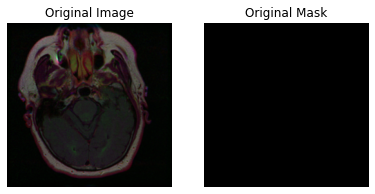

---------------------------------------------------------------------------
                    NO TUMOR DETECTED IN THE BELOW IMAGE


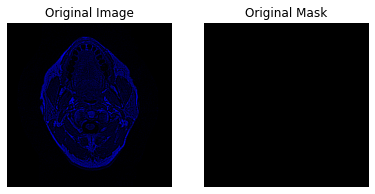

---------------------------------------------------------------------------


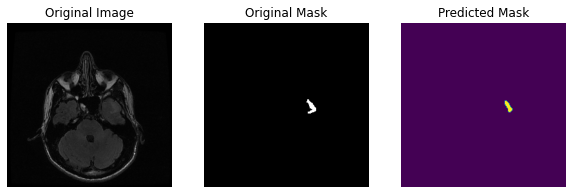

---------------------------------------------------------------------------
                    NO TUMOR DETECTED IN THE BELOW IMAGE


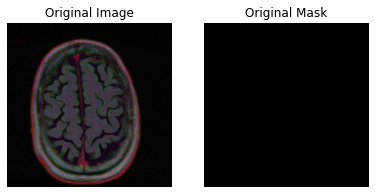

---------------------------------------------------------------------------


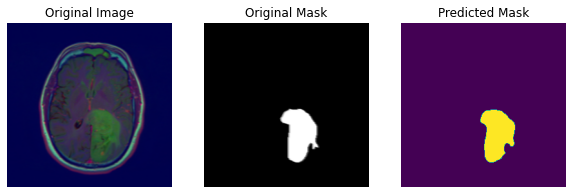

---------------------------------------------------------------------------
                    NO TUMOR DETECTED IN THE BELOW IMAGE


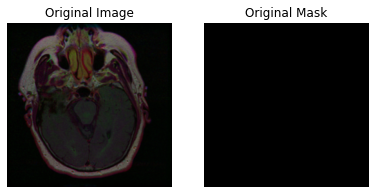

---------------------------------------------------------------------------
                    NO TUMOR DETECTED IN THE BELOW IMAGE


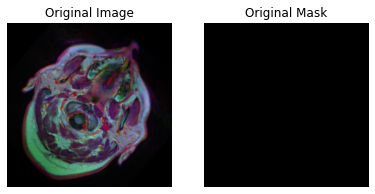

---------------------------------------------------------------------------


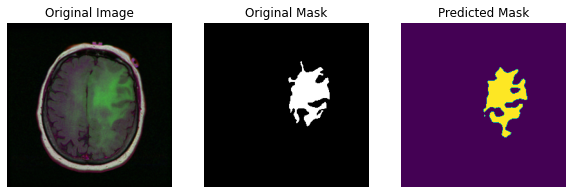

---------------------------------------------------------------------------
                    NO TUMOR DETECTED IN THE BELOW IMAGE


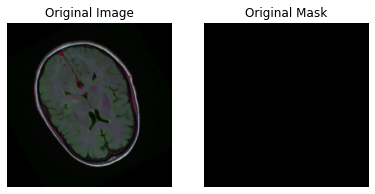

---------------------------------------------------------------------------


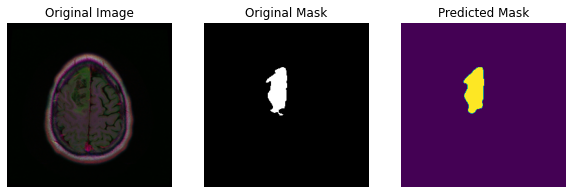

---------------------------------------------------------------------------
                    NO TUMOR DETECTED IN THE BELOW IMAGE


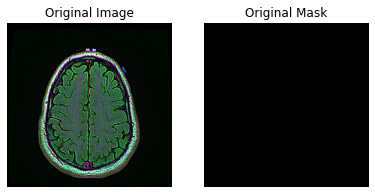

---------------------------------------------------------------------------
                    NO TUMOR DETECTED IN THE BELOW IMAGE


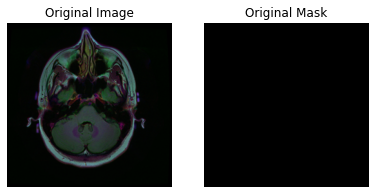

---------------------------------------------------------------------------


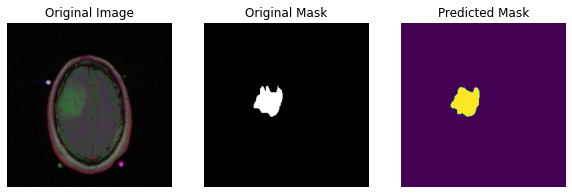

---------------------------------------------------------------------------


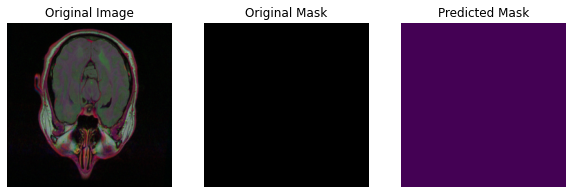

In [ ]:
data_out = tumorPrediction(df.sample(150, random_state=101), clfmodel, segmodel)

### Conclusion:

The Xception Classifier and the Unet model work in tandem to predict the presence of a tumor in the scan image and if tumor exists, the mask is predicted.

The masks closely replicate the original masks covering the finer details of the tumor shape. Even small sized tumors are successfully replicated to a good degree.

Also the absence a tumor is also detected as expected. 

In the above visualizations, we have the last sample case, where the classifier safely (mis)predicts a tumor where there was none (False Positive) but in the next level the Unet predicts the mask - without any tumor in it. This is preferred to a False Negative case in the medical problem statement.

We will deploy these models in tandem:
1. Xception Classifier
2. Unet Segmentation Model